In [1]:
red_color = "indianred"
blue_color = "#1E3C7C"
grey_color = "#6e6e6e"

### Imports

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
from cmdstanpy import cmdstan_path, set_cmdstan_path
import pickle as pkl
from rpy2.robjects import r
from rpy2.robjects.packages import importr
import re
from skbio.stats.composition import clr, alr_inv
import matplotlib as mpl
import arviz as az
import seaborn as sns
from scipy import stats as st
import matplotlib.patches as mpatches
os.environ["R_HOME"] = "path to R"
set_cmdstan_path("random_path" + ".conda/envs/stanpip/cmdstan-2.33.1") # set path where anaconda libraries are stored


In [ ]:
plot_path = "random_path_where_plots_are_stored"

### Load Data for Optimization Plots where D is varying

In [3]:
result_path = "random_path_where_results_are_stored"
os.chdir(result_path)
# Also I assume that all the optimizer results would be stored in optimizer_results folder. For varying_D don't need to do anything, for varying_N I assume they are stored in a separate folder in the optimzier_results folder

In [4]:
base = importr('base')

In [5]:
sorted_files = sorted(os.listdir('optimizer_results/'))

cpp_files = []
for folder in sorted_files:
    if folder.endswith('mycpp_0_0'):
            cpp_files.append("optimizer_results/" + folder + "/result_optim.RData")

cpp_optim_time_dict = {}
cpp_dir_time_dict = {}
cpp_total_time_dict = {}

for file in cpp_files:
        base.load(file)
        data = r['result_optim']
        data_py = list(data)
        cpp_optim_time_dict[file.split("/")[1]] = data_py[2][0]/1000
        cpp_dir_time_dict[file.split("/")[1]] = data_py[4][0]/1000
        cpp_total_time_dict[file.split("/")[1]] = data_py[5][0]

In [6]:
cpp_log_files = []
for folder in sorted_files:
    if folder.endswith('mycpp_0_0'):
            cpp_log_files.append("optimizer_results/" + folder + "/logprobs_cpp.csv")

cpp_num_iter_dict = {}
cpp_log_prob_dict = {}
for file in cpp_log_files:
      data = pd.read_csv(file,names=["multinomial","eta","total"])
      cpp_num_iter_dict[file.split("/")[1]] = data["multinomial"].shape[0]
      cpp_log_prob_dict[file.split("/")[1]] = data

In [7]:
stan_time_dict = {}

stan_time_files = []
for folder in sorted_files:
    if folder.endswith('sc_0_0'):
        for file in sorted(os.listdir('optimizer_results/' + folder)):
            if file.endswith('.csv'):
                stan_time_files.append("optimizer_results/" + folder + "/" + file)

for file in stan_time_files:
     data = pd.read_csv(file)
     stan_time_dict[file.split("/")[1]] = data["OptimizationTime"].iloc[-1]

stan_collapsed_files = []

for folder in sorted_files:
    if folder.endswith('sc_0_0'):
        for file in sorted(os.listdir('optimizer_results/' + folder + '/10000/')):
            if file.endswith('.csv'):
                stan_collapsed_files.append("optimizer_results/" + folder + "/10000/" + file)

stan_num_iter_dict = {}
stan_log_prob_dict = {}

for file in stan_collapsed_files[:]:
      print(file)
      data = pd.read_csv(file)
      data = data[["lp__"]]
      stan_num_iter_dict[file.split("/")[1]] = data.shape[0]
      stan_log_prob_dict[file.split("/")[1]] = data


optimizer_results/xi1/N600_D100_Q1_R10_W0.45_pm5_sc_0_0/10000/model-20240923130120.csv
optimizer_results/xi1/N600_D100_Q1_R1_W0.45_pm5_sc_0_0/10000/model-20240923114321.csv
optimizer_results/xi1/N600_D100_Q1_R2_W0.45_pm5_sc_0_0/10000/model-20240923114055.csv
optimizer_results/xi1/N600_D100_Q1_R3_W0.45_pm5_sc_0_0/10000/model-20240923114850.csv
optimizer_results/xi1/N600_D100_Q1_R4_W0.45_pm5_sc_0_0/10000/model-20240923120352.csv
optimizer_results/xi1/N600_D100_Q1_R5_W0.45_pm5_sc_0_0/10000/model-20240923120728.csv
optimizer_results/xi1/N600_D100_Q1_R6_W0.45_pm5_sc_0_0/10000/model-20240923121330.csv
optimizer_results/xi1/N600_D100_Q1_R7_W0.45_pm5_sc_0_0/10000/model-20240923123326.csv
optimizer_results/xi1/N600_D100_Q1_R8_W0.45_pm5_sc_0_0/10000/model-20240923123137.csv
optimizer_results/xi1/N600_D100_Q1_R9_W0.45_pm5_sc_0_0/10000/model-20240923124010.csv
optimizer_results/xi1/N600_D25_Q1_R10_W0.45_pm5_sc_0_0/10000/model-20240923094614.csv
optimizer_results/xi1/N600_D25_Q1_R1_W0.45_pm5_sc_0_0

In [8]:
stan_time_per_iter_dict = {k: stan_time_dict[k] / stan_num_iter_dict[k] for k in stan_time_dict}
cpp_time_per_iter_dict = {k: cpp_optim_time_dict[k] / cpp_num_iter_dict[k] for k in cpp_optim_time_dict}

### Load Data for Optimization plots when N is varying

In [9]:
sorted_files_N = sorted(os.listdir('optimizer_results/varying_N'))

cpp_files_N = []
for folder in sorted_files_N:
    if folder.endswith('mycpp_0_0'):
            cpp_files_N.append("optimizer_results/varying_N/" + folder + "/result_optim.RData")

cpp_optim_time_dict_N = {}
cpp_dir_time_dict_N = {}
cpp_total_time_dict_N = {}

for file in cpp_files_N:
        base.load(file)
        data = r['result_optim']
        data_py = list(data)
        cpp_optim_time_dict_N[file.split("/")[2]] = data_py[2][0]/1000
        cpp_dir_time_dict_N[file.split("/")[2]] = data_py[4][0]/1000
        cpp_total_time_dict_N[file.split("/")[2]] = data_py[5][0]

In [10]:
cpp_log_files_N = []
for folder in sorted_files_N:
    if folder.endswith('mycpp_0_0'):
            cpp_log_files_N.append("optimizer_results/varying_N/" + folder + "/logprobs_cpp.csv")

cpp_num_iter_dict_N = {}
cpp_log_prob_dict_N = {}
for file in cpp_log_files_N:
      data = pd.read_csv(file,names=["multinomial","eta","total"])
      cpp_num_iter_dict_N[file.split("/")[2]] = data["multinomial"].shape[0]
      cpp_log_prob_dict_N[file.split("/")[2]] = data

In [11]:
stan_time_dict_N = {}

stan_time_files_N = []
for folder in sorted_files_N:
    if folder.endswith('sc_0_0'):
        for file in sorted(os.listdir('optimizer_results/varying_N/' + folder)):
            if file.endswith('.csv'):
                stan_time_files_N.append("optimizer_results/varying_N/" + folder + "/" + file)

for file in stan_time_files_N:
     data = pd.read_csv(file)
     stan_time_dict_N[file.split("/")[2]] = data["OptimizationTime"].iloc[-1]

stan_collapsed_files_N = []

for folder in sorted_files_N:
    if folder.endswith('sc_0_0'):
        for file in sorted(os.listdir('optimizer_results/varying_N/' + folder + '/10000/')):
            if file.endswith('.csv'):
                stan_collapsed_files_N.append("optimizer_results/varying_N/" + folder + "/10000/" + file)

stan_num_iter_dict_N = {}
stan_log_prob_dict_N = {}

for file in stan_collapsed_files_N[:]:
      print(file)
      data = pd.read_csv(file)
      data = data[["lp__"]]
      stan_num_iter_dict_N[file.split("/")[2]] = data.shape[0]
      stan_log_prob_dict_N[file.split("/")[2]] = data


optimizer_results/xi1/varying_N/N1000_D30_Q1_R10_W0.45_pm5_sc_0_0/10000/model-20240923135501.csv
optimizer_results/xi1/varying_N/N1000_D30_Q1_R1_W0.45_pm5_sc_0_0/10000/model-20240923133910.csv
optimizer_results/xi1/varying_N/N1000_D30_Q1_R2_W0.45_pm5_sc_0_0/10000/model-20240923134124.csv
optimizer_results/xi1/varying_N/N1000_D30_Q1_R3_W0.45_pm5_sc_0_0/10000/model-20240923134231.csv
optimizer_results/xi1/varying_N/N1000_D30_Q1_R4_W0.45_pm5_sc_0_0/10000/model-20240923134458.csv
optimizer_results/xi1/varying_N/N1000_D30_Q1_R5_W0.45_pm5_sc_0_0/10000/model-20240923134550.csv
optimizer_results/xi1/varying_N/N1000_D30_Q1_R6_W0.45_pm5_sc_0_0/10000/model-20240923134857.csv
optimizer_results/xi1/varying_N/N1000_D30_Q1_R7_W0.45_pm5_sc_0_0/10000/model-20240923135821.csv
optimizer_results/xi1/varying_N/N1000_D30_Q1_R8_W0.45_pm5_sc_0_0/10000/model-20240923135138.csv
optimizer_results/xi1/varying_N/N1000_D30_Q1_R9_W0.45_pm5_sc_0_0/10000/model-20240923135316.csv
optimizer_results/xi1/varying_N/N2000_D

In [12]:
stan_time_per_iter_dict_N = {k: stan_time_dict_N[k] / stan_num_iter_dict_N[k] for k in stan_time_dict_N}
cpp_time_per_iter_dict_N = {k: cpp_optim_time_dict_N[k] / cpp_num_iter_dict_N[k] for k in cpp_optim_time_dict_N}

### Optimization Plots

In [16]:
# this is line plot
def plot_data_D_type1(stan_data, cpp_data, save_path, N_value='N600'):
    D_values = ['D25', 'D50', 'D75', 'D100']
    D_values_xtick = ['25', '50', '75', '100']
    stan_means = []
    stan_stds = []
    cpp_means = []
    cpp_stds = []

    # Collect data for each D value for both Stan and C++
    for D_value in D_values:
        stan_sims = np.array([stan_data[key] for key in stan_data if key.startswith(f'{N_value}_{D_value}_Q1')])
        cpp_sims = np.array([cpp_data[key] for key in cpp_data if key.startswith(f'{N_value}_{D_value}_Q1')])
        
        # Calculate means and standard deviations
        stan_means.append(np.mean(stan_sims))
        stan_stds.append(np.std(stan_sims))
        cpp_means.append(np.mean(cpp_sims))
        cpp_stds.append(np.std(cpp_sims))

    # Convert D_values into a numeric scale for plotting
    x_values = np.arange(len(D_values))

    # Plotting
    fig, ax = plt.subplots(figsize=(7, 4))

    # Plot lines with confidence intervals for C++ and Stan data
    ax.plot(x_values, cpp_means, color=red_color, label='FENRIR', marker='o')
    ax.fill_between(x_values, np.array(cpp_means) - np.array(cpp_stds), np.array(cpp_means) + np.array(cpp_stds), 
                    color=red_color, alpha=0.2)

    ax.plot(x_values, stan_means, color=blue_color, label='STAN', marker='o')
    ax.fill_between(x_values, np.array(stan_means) - np.array(stan_stds), np.array(stan_means) + np.array(stan_stds), 
                    color=blue_color, alpha=0.2)

    # Add labels and title
    ax.set_xticks(x_values)
    ax.set_xticklabels(D_values_xtick, fontsize=15)
    ax.set_xlabel('Number of Multinomial Categories', fontsize=15)
    # ax.set_ylabel('Time per Iteration (seconds)', fontsize=15)
    ax.set_ylabel('Total Time (seconds)', fontsize=15)
    plt.yticks(fontsize=14)
    # Add legend
    ax.legend(loc='upper left')
    plt.savefig(save_path, format="pdf", bbox_inches="tight")
    fig.tight_layout()
    plt.show()

In [17]:
plot_data_D_type1(stan_time_per_iter_dict, cpp_time_per_iter_dict, save_path = f"{plot_path}/plots/D_vary_per_iter.pdf")

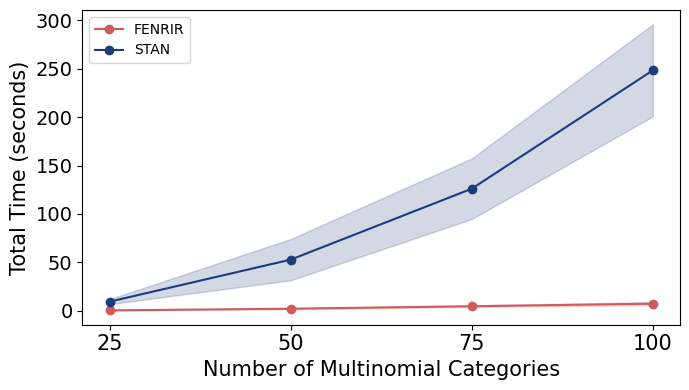

In [18]:
plot_data_D_type1(stan_time_dict, cpp_optim_time_dict, save_path = f"{plot_path}/plots/D_vary_total.pdf")

In [21]:
# this is line plot for varying-N
def plot_data(stan_data, cpp_data, save_path, D_value='D30'):
    N_values = ['N200', 'N500', 'N1000', 'N2000', 'N4000']
    N_values_xticks = ['200', '500', '1000', '2000', '4000']
    stan_means = []
    stan_stds = []
    cpp_means = []
    cpp_stds = []

    # Collect data for each N value for both Stan and C++
    for N_value in N_values:
        stan_sims = np.array([stan_data[key] for key in stan_data if key.startswith(f'{N_value}_{D_value}_Q1')])
        cpp_sims = np.array([cpp_data[key] for key in cpp_data if key.startswith(f'{N_value}_{D_value}_Q1')])
        # Calculate means and standard deviations
        stan_means.append(np.mean(stan_sims))
        stan_stds.append(np.std(stan_sims))
        cpp_means.append(np.mean(cpp_sims))
        cpp_stds.append(np.std(cpp_sims))

    # Convert N_values into a numeric scale for plotting
    x_values = np.arange(len(N_values))

    # Plotting
    fig, ax = plt.subplots(figsize=(7, 4))
    # Plot lines with confidence intervals for C++ and Stan data
    ax.plot(x_values, cpp_means, color=red_color, label='FENRIR', marker='o')
    ax.fill_between(x_values, np.array(cpp_means) - np.array(cpp_stds), np.array(cpp_means) + np.array(cpp_stds), 
                    color=red_color, alpha=0.2)

    ax.plot(x_values, stan_means, color=blue_color, label='STAN', marker='o')
    ax.fill_between(x_values, np.array(stan_means) - np.array(stan_stds), np.array(stan_means) + np.array(stan_stds), 
                    color=blue_color, alpha=0.2)

    # Add labels and title
    ax.set_xticks(x_values)
    ax.set_xticklabels(N_values_xticks, fontsize=15)
    ax.set_xlabel('Number of Timepoints', fontsize=15)
    # ax.set_ylabel('Total Time (seconds)', fontsize=15)
    ax.set_ylabel('Time per Iteration (seconds)', fontsize=15)
    # Add legend
    ax.legend(loc='upper left')
    plt.yticks(fontsize=14)
    fig.tight_layout()
    plt.savefig(save_path, format="pdf", bbox_inches="tight")
    plt.show()


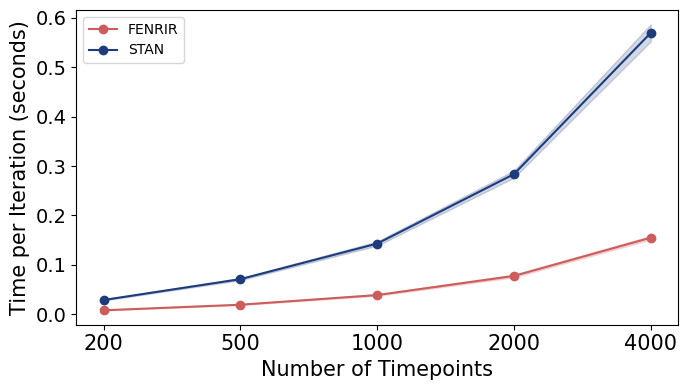

In [22]:
plot_data(stan_time_per_iter_dict_N, cpp_time_per_iter_dict_N, save_path = f"{plot_path}/plots/N_vary_per_iter.pdf")

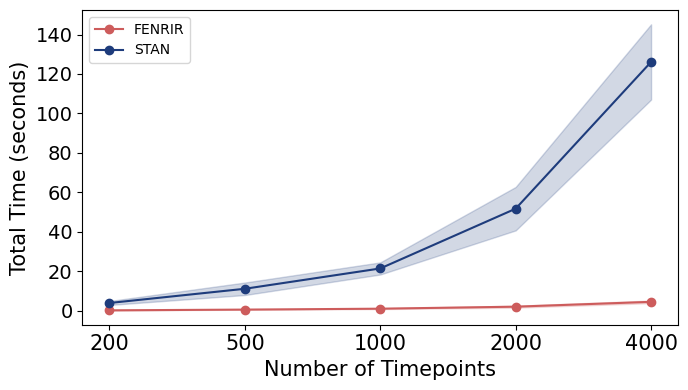

In [20]:
plot_data(stan_time_dict_N, cpp_optim_time_dict_N, save_path = f"{plot_path}/plots/N_vary_total.pdf")

In [36]:
ratio_values = {}
values = ["N600_D25_Q1", "N600_D50_Q1", "N600_D75_Q1", "N600_D100_Q1"]

for val in values:
    for sim in ["R1","R2","R3","R4","R5","R6","R7","R8","R9","R10"]:
        stan_values = stan_log_prob_dict[val+"_"+sim+"_W0.45_pm5_sc_0_0"]["lp__"]
        cpp_values = cpp_log_prob_dict[val+"_"+sim+"_W0.45_pm5_mycpp_0_0"]["total"] + stan_log_prob_dict[val+"_"+sim+"_W0.45_pm5_sc_0_0"]["lp__"].iloc[0] - cpp_log_prob_dict[val+"_"+sim+"_W0.45_pm5_mycpp_0_0"]["total"].iloc[0]
        num_cpp_vals = len(cpp_values)
        num_stan_vals = len(stan_values)
        ratio = np.array(stan_values)[:num_cpp_vals] / np.array(cpp_values)
        ratio_values[val+"_"+sim] = ratio

In [37]:
def normalize_arrays(data_dict, key_prefix):
    max_length = max(data_dict[key].size for key in data_dict if key.startswith(key_prefix))
    for key in data_dict:
        if key.startswith(key_prefix):
            current_length = data_dict[key].size
            if current_length < max_length:
                last_value = data_dict[key][-1]
                additional_length = max_length - current_length
                data_dict[key] = np.concatenate((data_dict[key], np.full((additional_length,), last_value)))


In [38]:
def plot_data(data_dict, N_value='N600'):
    # Define the figure
    fig, ax = plt.subplots(figsize=(7, 4))
    D_values = ['D25', 'D50', 'D75', 'D100']

    cmap = plt.get_cmap('bone')
    colors = cmap(np.linspace(0.1, 0.7, len(D_values)))

    for i, D_value in enumerate(D_values):
        # Extracting just the numerical part of D_value for the legend
        taxa_number = D_value[1:]  # Removes the 'D' from D_value

        # Collect all data for this D_value
        simulations = [data_dict[key] for key in data_dict if key.startswith(f'{N_value}_{D_value}_Q1')]
        simulations = np.array(simulations)

        # Compute mean and 95% confidence interval
        mean_values = np.mean(simulations, axis=0)

        # Prepare x values (assuming iterations are equal to indices)
        x = np.arange(1, len(mean_values) + 1)

        ax.plot(x, mean_values, label=f'{taxa_number} categories', color=colors[i])

    # Setting axes labels
    ax.set_xlabel('Number of Iterations', fontsize=15)
    ax.set_ylabel('Ratio of Log Probabilities', fontsize=15)
    

    # Adding legend to the plot
    ax.legend(loc='lower right', fontsize=15)

    # Adjusting layout to avoid overlap and make space for the title
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=14)
    plt.savefig(f"{plot_path}/D_vary_logprob.pdf", format="pdf", bbox_inches="tight")
    plt.show()


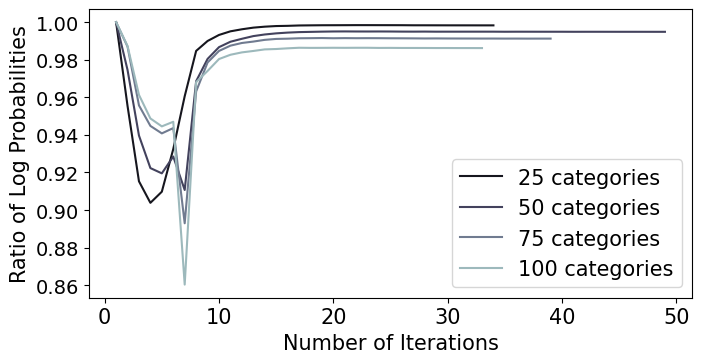

In [39]:
# Normalize list lengths for each group
for D_value in ['D25', 'D50', 'D75','D100']:
    normalize_arrays(ratio_values, f'N600_{D_value}_Q1')

# Plot the data
plot_data(ratio_values)


In [40]:
ratio_values = {}
values = ["N200_D30_Q1", "N500_D30_Q1", "N1000_D30_Q1", "N2000_D30_Q1", "N4000_D30_Q1"]

for val in values:
    for sim in ["R1","R2","R3","R4","R5","R6","R7","R8","R9","R10"]:
        stan_values = stan_log_prob_dict_N[val+"_"+sim+"_W0.45_pm5_sc_0_0"]["lp__"]
        cpp_values = cpp_log_prob_dict_N[val+"_"+sim+"_W0.45_pm5_mycpp_0_0"]["total"] + stan_log_prob_dict_N[val+"_"+sim+"_W0.45_pm5_sc_0_0"]["lp__"].iloc[0] - cpp_log_prob_dict_N[val+"_"+sim+"_W0.45_pm5_mycpp_0_0"]["total"].iloc[0]
        num_cpp_vals = len(cpp_values)
        num_stan_vals = len(stan_values)
        ratio = np.array(stan_values)[:num_cpp_vals] / np.array(cpp_values)
        ratio_values[val+"_"+sim] = ratio

In [41]:
def plot_data(data_dict, D_value='D30'):
    # Define the figure
    fig, ax = plt.subplots(figsize=(7, 4))
    N_values = ['N200', 'N500', 'N1000', 'N2000', 'N4000']

    cmap = plt.get_cmap('bone')
    colors = cmap(np.linspace(0.05, 1, len(N_values)))

    for i, N_value in enumerate(N_values):
        taxa_number = N_value[1:] 
        simulations = [data_dict[key] for key in data_dict if key.startswith(f'{N_value}_{D_value}_Q1')]
        simulations = np.array(simulations)
        mean_values = np.mean(simulations, axis=0)
        x = np.arange(1, len(mean_values) + 1)
        ax.plot(x, mean_values, label=f'{taxa_number} timepoints', color=colors[i])

    ax.set_xlabel('Number of Iterations', fontsize=15)
    ax.set_ylabel('Ratio of Log Probabilities', fontsize=14)
    
    # Adding legend to the plot
    ax.legend(loc='lower right', fontsize=15)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=14)
    # Adjusting layout to avoid overlap and make space for the title
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.savefig(f"{plot_path}/N_vary_logprob.pdf", format="pdf", bbox_inches="tight")
    plt.show()


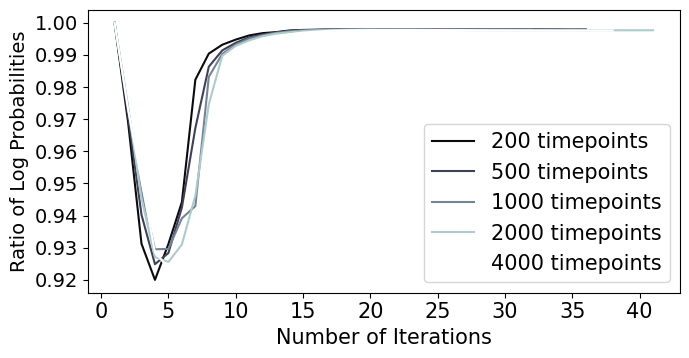

In [42]:
# Normalize list lengths for each group
for N_value in ['N200', 'N500', 'N1000', 'N2000', 'N4000']:
    normalize_arrays(ratio_values, f'{N_value}_D30_Q1')

# Plot the data
plot_data(ratio_values)

### Mallard Dataset Plot

In [94]:
result_path = "random_path_where_results_on_microbiome_data_are_stored"
os.chdir(result_path)
# I assume Fenrir results are stored in a cpp folder and Stan results are stored in stan folder.

In [95]:
seq_list = ["seq_6","seq_15","seq_5","seq_10","seq_1","seq_2","seq_14","seq_23","seq_9" ,"seq_4"]

family_names = [
    "Synergistaceae", 
    "Fusobacteriaceae", 
    "Acidaminococcaceae", 
    "Ruminococcaceae", 
    "Lachnospiraceae", 
    "Rikenellaceae", 
    "Bacteroidaceae", 
    "Porphyromonadaceae", 
    "Desulfovibrionaceae", 
    "Enterobacteriaceae"
]

In [96]:
base_mallard = importr('base')
base_mallard.load('./cpp/result_theta_dir_without_mcmc_clr_gibbs.RData')
data_nomcmc_mallard_clr = r['smoothed_theta_nomcmc_clr']
theta_nomcmc_mallard_clr = np.array(data_nomcmc_mallard_clr).transpose(1,2,0)

In [97]:
fit_mallard = None
with open("./stan/fit.pkl", 'rb') as file:
    fit_mallard = pkl.load(file)

theta_stan_mallard = fit_mallard.stan_variable("theta",inc_warmup=False)[:,:,:,:]
theta_stan_mallard = theta_stan_mallard.squeeze().transpose(2,1,0)
theta_stan_mallard_clr = []

for i in range(theta_stan_mallard.shape[2]):
    proportion = alr_inv(theta_stan_mallard[:,:,i].T)
    theta_stan_mallard_clr.append(clr(proportion).T)

theta_stan_mallard_clr = np.array(theta_stan_mallard_clr).transpose(1,2,0)
print(theta_stan_mallard_clr.shape, theta_nomcmc_mallard_clr.shape)

(10, 2692, 12000) (10, 2692, 4000)


#### Optim Analysis

In [73]:
cpp_file = "./cpp/optimizer/logprobs_cpp.csv"
data = pd.read_csv(cpp_file, names=["multinomial","eta","total"])
cpp_num_iter = data["multinomial"].shape[0]
cpp_log_prob = data

In [74]:
stan_file = "./stan/optimizer/10000/model-20240903155549.csv"
data = pd.read_csv(stan_file)
data = data[["lp__"]]
stan_num_iter = data.shape[0]
stan_log_prob = data

In [75]:
stan_values = stan_log_prob["lp__"]
cpp_values = cpp_log_prob["total"] + stan_log_prob["lp__"].iloc[0] - cpp_log_prob["total"].iloc[0]
num_cpp_vals = len(cpp_values)
num_stan_vals = len(stan_values)
print(num_cpp_vals, num_stan_vals)
ratio = np.array(stan_values)[:num_cpp_vals] / np.array(cpp_values)

148 335


Text(0, 0.5, 'Ratio of Log Probabilities')

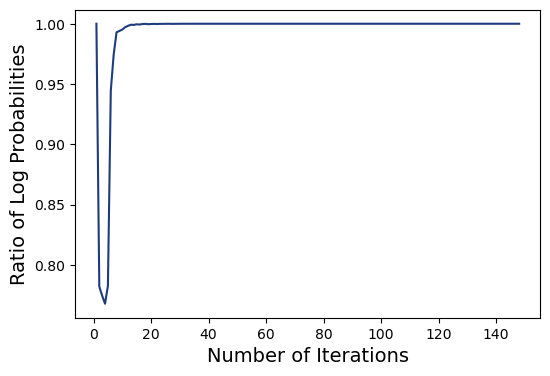

In [155]:
plt.figure(figsize=(6,4))
plt.plot(np.arange(1,len(ratio)+1), ratio, color=blue_color)

plt.grid(False)
plt.xlabel('Number of Iterations',fontsize=14)
plt.ylabel('Ratio of Log Probabilities',fontsize=14)
plt.savefig(f"{plot_path}/mallard_logprob.pdf", format="pdf", bbox_inches="tight")

In [79]:
file = "./cpp/optimizer/result_optim.RData"

base_mallard.load(file)
data = r['result_optim']
data_py = list(data)
cpp_optim_time = data_py[2][0]/1000
cpp_dir_time = data_py[4][0]/1000
cpp_total_time = data_py[5][0]

print(cpp_optim_time, cpp_dir_time, cpp_total_time)

0.855 0.662 1.5354161262512207


In [77]:
stan_time_file = "./stan/optimizer/optimization_times.csv"

data = pd.read_csv(stan_time_file)
stan_time = data["OptimizationTime"].iloc[-1]

print(stan_time)

13.9637451171875


In [78]:
stan_time_per_iter = stan_time/stan_num_iter
cpp_time_per_iter = cpp_total_time/cpp_num_iter

print(stan_time_per_iter, cpp_time_per_iter)

0.04168282124533582 0.010374433285481221


#### W Analysis

In [69]:
W_stan = fit_mallard.stan_variable("W",inc_warmup=False)

In [70]:
W_stan.mean(), np.percentile(W_stan, 2.5), np.percentile(W_stan, 97.5)

(0.14327899191666665, 0.128442, 0.15921259999999998)

In [71]:
W_base = importr('base')
W_base.load('./cpp/W_gibbs.RData')
W_data = r['W_ct']
W_data = np.array(W_data[0])[1000:].flatten()

In [72]:
W_data.shape, W_data.mean(), np.percentile(W_data, 2.5), np.percentile(W_data, 97.5)

((3000,), 0.14615210268295034, 0.1323755055949053, 0.16421497748447378)

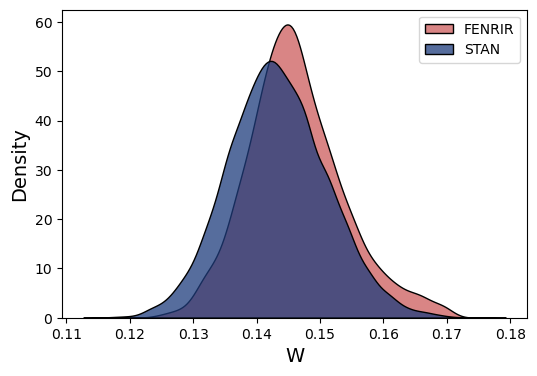

In [116]:
plt.figure(figsize=(6,4))
sns.kdeplot(W_data[:], fill=True, color = red_color, label="FENRIR", multiple="stack")
sns.kdeplot(W_stan[:], fill=True, color = blue_color, label="STAN", multiple="stack")
plt.grid(False)
plt.xlabel('W',fontsize=14)
plt.ylabel('Density',fontsize=14)
plt.legend()
plt.savefig(f"{plot_path}/plots/W_density.pdf", format="pdf", bbox_inches="tight")


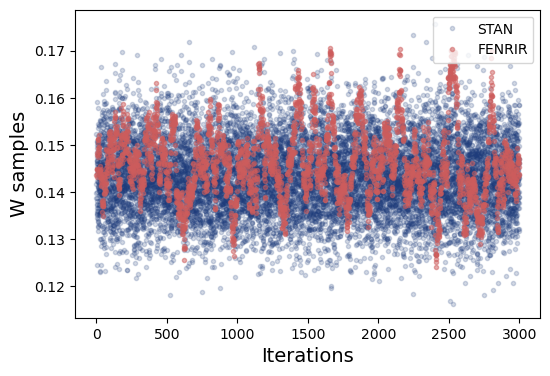

In [117]:
plt.figure(figsize=(6,4))
plt.plot(np.arange(0, 3000, 1), W_stan[0:3000], '.', color=blue_color, alpha=0.2, label="STAN")
plt.plot(np.arange(0, 3000, 1), W_stan[3000:6000], '.', color=blue_color, alpha=0.2)
plt.plot(np.arange(0, 3000, 1), W_stan[6000:9000], '.', color=blue_color, alpha=0.2)
plt.plot(np.arange(0, 3000, 1), W_stan[9000:12000], '.', color=blue_color, alpha=0.2)
plt.plot(np.arange(0, 3000, 1), W_data[:], '.', color=red_color, alpha=0.5, label="FENRIR")
plt.grid(False)
plt.xlabel('Iterations',fontsize=14)
plt.ylabel('W samples',fontsize=14)
plt.legend(loc='upper right')
plt.savefig(f"{plot_path}/plots/W_trace.pdf", format="pdf", bbox_inches="tight")

#### 4 taxas for vessel 2

In [115]:
def plot_theta_multi_ts(samples, stan_samples, features = np.arange(0,10,1), seed=123, timepoints=673):
    np.random.seed(seed)
    
    # Compute statistics
    samples_mean = np.mean(samples, axis=2)
    samples_2_5_matrix = np.percentile(samples, 2.5, axis=2)
    samples_97_5_matrix = np.percentile(samples, 97.5, axis=2)

    stan_samples_mean = np.mean(stan_samples, axis=2)
    stan_samples_2_5_matrix = np.percentile(stan_samples, 2.5, axis=2)
    stan_samples_97_5_matrix = np.percentile(stan_samples, 97.5, axis=2)

    # Setup figure and axes
    fig, axs = plt.subplots(2, 2, figsize=(10, 6), squeeze=False, sharex=True)
    # Define proxy artists for legend
    handles = []

    for i, feature_index in enumerate(features):
        ax = axs[i % 2, i // 2]
        time_points = np.arange(timepoints)

        # Plot means and confidence intervals
        l1 = ax.plot(time_points, stan_samples_mean[feature_index], '--', color=blue_color, linewidth=2)
        f1 = ax.fill_between(time_points, stan_samples_2_5_matrix[feature_index], stan_samples_97_5_matrix[feature_index], color=blue_color, alpha=0.2)
        l2 = ax.plot(time_points, samples_mean[feature_index], color=red_color, linewidth=2)
        f2 = ax.fill_between(time_points, samples_2_5_matrix[feature_index], samples_97_5_matrix[feature_index], color=red_color, alpha=0.2)

        if feature_index == 0:
            # Only add to legend once
            handles.extend([l1[0], mpatches.Patch(color=blue_color, alpha=0.2), l2[0], mpatches.Patch(color=red_color, alpha=0.2)])

        ax.set_title(f'{family_names[feature_index]}', fontsize=18)
        ax.grid(False)
        ax.margins(0, 0)
        ax.xaxis.set_tick_params(labelsize=18)
        ax.yaxis.set_tick_params(labelsize=18)
    # Global figure adjustments
    fig.legend(handles, ['STAN Mean', 'STAN 95% CI', 'FENRIR Mean', 'FENRIR 95% CI'], loc='lower center', bbox_to_anchor=(0.5, -0.12), ncol=4, fontsize=16)
    fig.text(0.5, -0.01, 'Time (Hours)', ha='center', va='center', fontsize=18)
    fig.text(0.0, 0.5, 'CLR Coordinates', ha='center', va='center', rotation='vertical', fontsize=18)
    
    plt.tight_layout(pad=1.5)
    plt.savefig(f"{plot_path}/plots/mallard_nomcmc_4_taxa.pdf", format="pdf", bbox_inches="tight")
    plt.show()

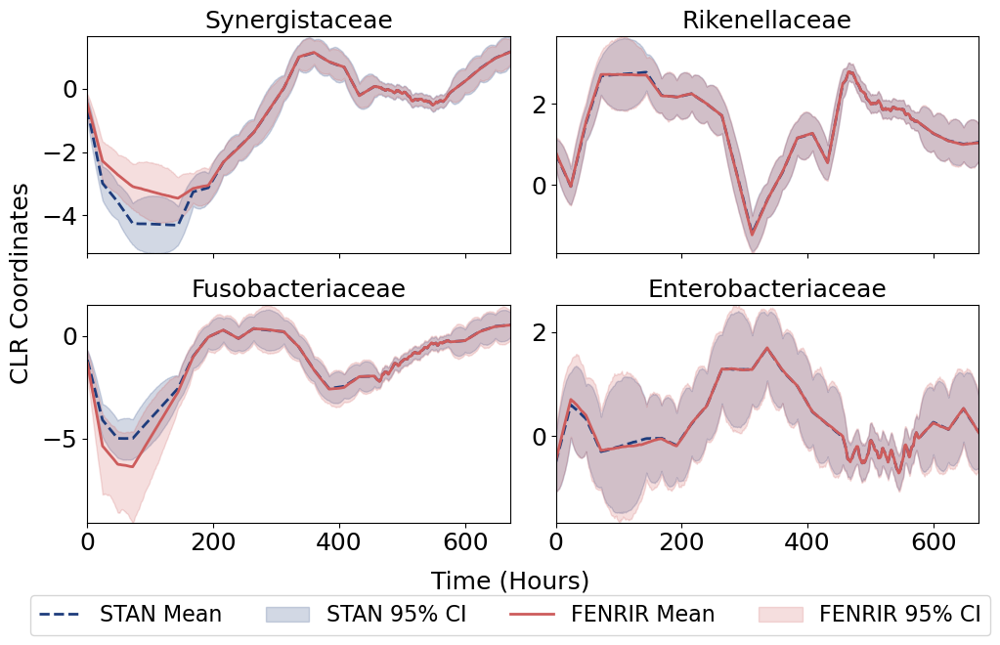

In [116]:
plot_theta_multi_ts(theta_nomcmc_mallard_clr[:,673:673*2,:],theta_stan_mallard_clr[:,673:673*2,:], features=[0,1,5,9], seed=123, timepoints = 673)

#### All taxas

In [131]:
def plot_theta_multi_ts(samples, stan_samples, N_total_list, num_of_timeseries=4, num_of_features=10, seed=123, which_times=(0, 100), label_suffixes = ["ours","stan"]):
    np.random.seed(seed)

    # Assuming samples and stan_samples are indexed as [feature, time, timeseries]
    samples_mean = np.mean(samples, axis=2)
    samples_2_5_matrix = np.percentile(samples, 2.5, axis=2)
    samples_97_5_matrix = np.percentile(samples, 97.5, axis=2)

    stan_samples_mean = np.mean(stan_samples, axis=2)
    stan_samples_2_5_matrix = np.percentile(stan_samples, 2.5, axis=2)
    stan_samples_97_5_matrix = np.percentile(stan_samples, 97.5, axis=2)

    # Create 10x4 subplots
    fig, axs = plt.subplots(num_of_features, num_of_timeseries, figsize=(30, 40), squeeze=False, sharex=True)  # Adjust figsize as needed

    handles = []
    
    for feature_index in range(num_of_features):
        cum_index = 0  # Reset for each feature
        for ts_index in range(num_of_timeseries):
            ax = axs[feature_index, ts_index]

            # Extract data for the selected feature across the current time series
            selected_mean = samples_mean[feature_index, cum_index:cum_index + N_total_list[ts_index]]
            selected_percentile_2_5 = samples_2_5_matrix[feature_index, cum_index:cum_index + N_total_list[ts_index]]
            selected_percentile_97_5 = samples_97_5_matrix[feature_index, cum_index:cum_index + N_total_list[ts_index]]
            stan_selected_mean = stan_samples_mean[feature_index, cum_index:cum_index + N_total_list[ts_index]]
            stan_selected_percentile_2_5 = stan_samples_2_5_matrix[feature_index, cum_index:cum_index + N_total_list[ts_index]]
            stan_selected_percentile_97_5 = stan_samples_97_5_matrix[feature_index, cum_index:cum_index + N_total_list[ts_index]]
            time_points = np.arange(N_total_list[ts_index])

            # Plot mean lines and confidence intervals
            l1,f1,l2,f2 = "","","",""
            for color, label_suffix in zip([red_color, blue_color], label_suffixes):
                
                if label_suffix == label_suffixes[1]:
                    l1 = ax.plot(time_points[which_times[0]:which_times[1]], stan_selected_mean[which_times[0]:which_times[1]],'--' ,color=color,linewidth=2)
                    f1 = ax.fill_between(time_points[which_times[0]:which_times[1]], stan_selected_percentile_2_5[which_times[0]:which_times[1]], stan_selected_percentile_97_5[which_times[0]:which_times[1]], color=blue_color, alpha=0.2)
                else:
                    l2 = ax.plot(time_points[which_times[0]:which_times[1]], selected_mean[which_times[0]:which_times[1]], color=color,linewidth=2)
                    f2 = ax.fill_between(time_points[which_times[0]:which_times[1]], selected_percentile_2_5[which_times[0]:which_times[1]], selected_percentile_97_5[which_times[0]:which_times[1]], color=color, alpha=0.2)
            if feature_index == 0:
                handles.extend([l1[0], mpatches.Patch(color=blue_color, alpha=0.2), l2[0], mpatches.Patch(color=red_color, alpha=0.2)])
            # Legend and labels
            ax.set_title(f'{family_names[feature_index]}- Vessel {ts_index + 1}', fontsize=30)
            ax.grid(False)
            ax.margins(0, 0)
            ax.xaxis.set_tick_params(labelsize=28)
            ax.yaxis.set_tick_params(labelsize=28)
            cum_index += N_total_list[ts_index]

    fig.legend(handles, ['STAN Mean', 'STAN 95% CI', 'FENRIR Mean', 'FENRIR 95% CI'], loc='lower center', bbox_to_anchor=(0.5, -0.07), ncol=4, fontsize=42)
    fig.text(0.5, -0.01, 'Time (Hours)', ha='center', va='center', fontsize=48)
    fig.text(-0.02, 0.5, 'CLR Coordinates', ha='center', va='center', rotation='vertical', fontsize=48)
    plt.tight_layout()
    plt.savefig(f"{plot_path}/plots/all_mallard_nomcmc.pdf", format="pdf", bbox_inches="tight")
    plt.show()

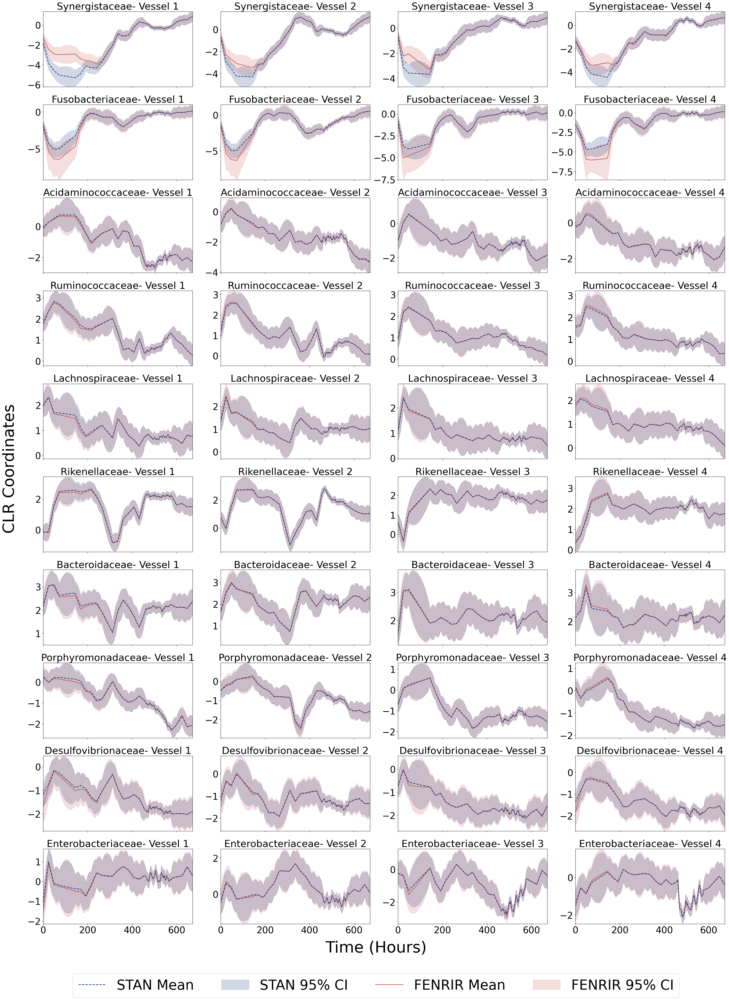

In [132]:
plot_theta_multi_ts(theta_nomcmc_mallard_clr,theta_stan_mallard_clr, [673,673,673,673], num_of_timeseries=4, num_of_features=10, seed=123, which_times=(0, 673), label_suffixes = ["ours","stan"])

### Simulated Dirichlet Plots

In [43]:
results_path = "random_path_where_simulated_data_results_are_stored"
os.chdir(results_path)

In [44]:
base_nomcmc = importr('base')
base_nomcmc.load("./N300_D3_Q1_R1_W0.45_pm5_mycpp_0_1/result_theta_dir_without_mcmc_clr.RData")
data_nomcmc_clr = r['smoothed_theta_nomcmc_clr']
theta_nomcmc_clr = np.array(data_nomcmc_clr).transpose(1,2,0)

base_nomcmc.load("./N300_D3_Q1_R1_W0.45_pm5_mycpp_0_1/result_optim.RData")
data = r['result_optim']
data_py = list(data)
cpp_optim_time = data_py[2][0]/1000
cpp_dir_time = data_py[4][0]/1000
cpp_total_time = data_py[5][0]

In [45]:
fit = None
with open("./N300_D3_Q1_R1_W0.45_pm5_sc_0_1/fit.pkl", 'rb') as file:
    fit = pkl.load(file)

theta_stan = fit.stan_variable("theta",inc_warmup=False)[:,:,:,:]
theta_stan = theta_stan.squeeze().transpose(2,1,0)
theta_stan_clr = []

for i in range(theta_stan.shape[2]):
    proportion = alr_inv(theta_stan[:,:,i].T)
    theta_stan_clr.append(clr(proportion).T)

theta_stan_clr = np.array(theta_stan_clr).transpose(1,2,0)
print(theta_stan_clr.shape, theta_nomcmc_clr.shape)

(3, 300, 12000) (3, 300, 2000)


In [68]:
def plot_ts_combined(samples, stan_samples, N_total_list, num_of_timeseries=4, seed=123, which_times=(0,100)):
    np.random.seed(seed)

    samples_mean = np.mean(samples, axis=2)
    samples_2_5_matrix = np.percentile(samples, 2.5, axis=2)
    samples_97_5_matrix = np.percentile(samples, 97.5, axis=2)

    stan_samples_mean = np.mean(stan_samples, axis=2)
    stan_samples_2_5_matrix = np.percentile(stan_samples, 2.5, axis=2)
    stan_samples_97_5_matrix = np.percentile(stan_samples, 97.5, axis=2)

    time_points = np.arange(sum(N_total_list))

    fig, axs = plt.subplots(3, 1, figsize=(15, 5 * 3), squeeze=False)
    
    for i in range(3):
        ax = axs[i, 0]
        ax.plot(time_points[which_times[0]:which_times[1]], stan_samples_mean[i][which_times[0]:which_times[1]], '--',label='STAN Mean', color=blue_color, linewidth=2)
        ax.fill_between(time_points[which_times[0]:which_times[1]], stan_samples_2_5_matrix[i][which_times[0]:which_times[1]], stan_samples_97_5_matrix[i][which_times[0]:which_times[1]], label="STAN 95% CI", color=blue_color, alpha=0.2)
        ax.plot(time_points[which_times[0]:which_times[1]], samples_mean[i][which_times[0]:which_times[1]], label='FENRIR Mean', color=red_color, linewidth=2)
        ax.fill_between(time_points[which_times[0]:which_times[1]], samples_2_5_matrix[i][which_times[0]:which_times[1]], samples_97_5_matrix[i][which_times[0]:which_times[1]], label="FENRIR 95% CI", color=red_color, alpha=0.2)
        ax.set_title(f"Multinomial Category {i+1}",fontsize=24)
        ax.grid(False)
        ax.xaxis.set_tick_params(labelsize=24)
        ax.yaxis.set_tick_params(labelsize=24)

    handles, labels = ax.get_legend_handles_labels()
    fig.legend(handles, labels, loc='lower center', bbox_to_anchor=(0.5, -0.08), ncol=4, fontsize=24)
    fig.text(0.5, -0.01, 'Timepoints', ha='center', va='center', fontsize=24)
    fig.text(0.0, 0.5, 'CLR Coordinates', ha='center', va='center', rotation='vertical', fontsize=30)
    plt.tight_layout()
    plt.savefig(f"{plot_path}/plots/dirichlet_simulated.pdf", format="pdf", bbox_inches="tight")

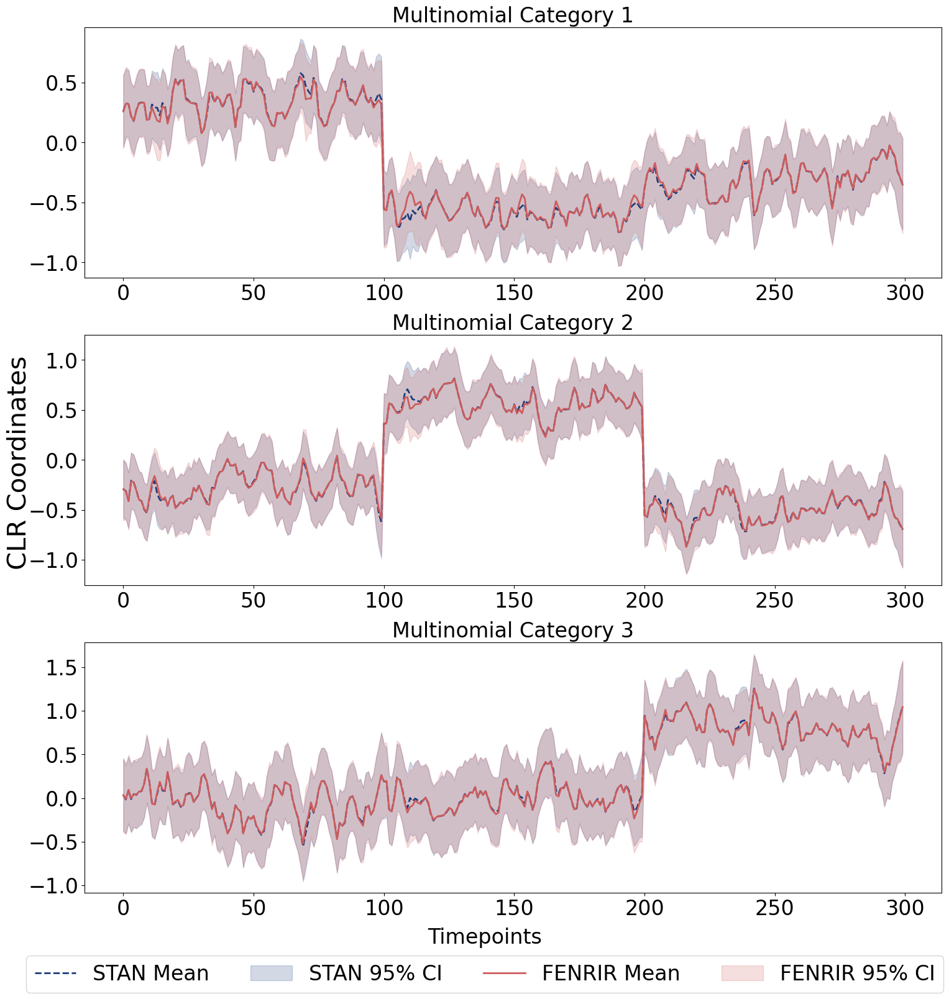

In [69]:
plot_ts_combined(theta_nomcmc_clr, theta_stan_clr, [100,100,100], 3, 123, (0,300))

In [70]:
base_nomcmc.load("./N300_D10_Q1_R1_W0.45_pm5_mycpp_0_1/result_theta_dir_without_mcmc_clr.RData")
data_nomcmc_clr = r['smoothed_theta_nomcmc_clr']
theta_nomcmc_clr = np.array(data_nomcmc_clr).transpose(1,2,0)

base_nomcmc.load("./N300_D10_Q1_R1_W0.45_pm5_mycpp_0_1/result_optim.RData")
data = r['result_optim']
data_py = list(data)
cpp_optim_time = data_py[2][0]/1000
cpp_dir_time = data_py[4][0]/1000
cpp_total_time = data_py[5][0]

In [71]:
fit = None
with open("./N300_D10_Q1_R1_W0.45_pm5_sc_0_1/fit.pkl", 'rb') as file:
    fit = pkl.load(file)

theta_stan = fit.stan_variable("theta",inc_warmup=False)[:,:,:,:]
theta_stan = theta_stan.squeeze().transpose(2,1,0)
theta_stan_clr = []

for i in range(theta_stan.shape[2]):
    proportion = alr_inv(theta_stan[:,:,i].T)
    theta_stan_clr.append(clr(proportion).T)

theta_stan_clr = np.array(theta_stan_clr).transpose(1,2,0)
print(theta_stan_clr.shape, theta_nomcmc_clr.shape)

(10, 300, 12000) (10, 300, 2000)


In [92]:
def plot_ts_combined(samples, stan_samples, N_total_list, num_of_timeseries=4, seed=123, which_times=(0,100)):
    np.random.seed(seed)
    samples_mean = np.mean(samples, axis=2)
    samples_2_5_matrix = np.percentile(samples, 2.5, axis=2)
    samples_97_5_matrix = np.percentile(samples, 97.5, axis=2)
    stan_samples_mean = np.mean(stan_samples, axis=2)
    stan_samples_2_5_matrix = np.percentile(stan_samples, 2.5, axis=2)
    stan_samples_97_5_matrix = np.percentile(stan_samples, 97.5, axis=2)
    time_points = np.arange(sum(N_total_list))
    fig, axs = plt.subplots(5, 2, figsize=(20, 25), squeeze=False)
    
    for i in range(10):
        ax = axs[i % 5, i // 5]
        ax.plot(time_points[which_times[0]:which_times[1]], stan_samples_mean[i][which_times[0]:which_times[1]], '--',label='STAN Mean', color=blue_color, linewidth=2)
        ax.fill_between(time_points[which_times[0]:which_times[1]], stan_samples_2_5_matrix[i][which_times[0]:which_times[1]], stan_samples_97_5_matrix[i][which_times[0]:which_times[1]], label="STAN 95% CI", color=blue_color, alpha=0.2)
        ax.plot(time_points[which_times[0]:which_times[1]], samples_mean[i][which_times[0]:which_times[1]], label='FENRIR Mean', color=red_color, linewidth=2)
        ax.fill_between(time_points[which_times[0]:which_times[1]], samples_2_5_matrix[i][which_times[0]:which_times[1]], samples_97_5_matrix[i][which_times[0]:which_times[1]], label="FENRIR 95% CI", color=red_color, alpha=0.2)
        ax.set_title(f"Multinomial Category {i+1}", fontsize=24)
        ax.grid(False)
        ax.tick_params(axis='both', which='major', labelsize=24)
        
    handles, labels = ax.get_legend_handles_labels()
    fig.legend(handles, labels, loc='lower center', bbox_to_anchor=(0.5, -0.08), ncol=4, fontsize=30)
    fig.text(0.5, -0.01, 'Timepoints', ha='center', va='center', fontsize=30)
    fig.text(0.0, 0.5, 'CLR Coordinates', ha='center', va='center', rotation='vertical', fontsize=30)
    
    plt.tight_layout(pad=3)
    plt.savefig(f"{plot_path}/plots/dirichlet_simulated_10.pdf", format="pdf", bbox_inches="tight")

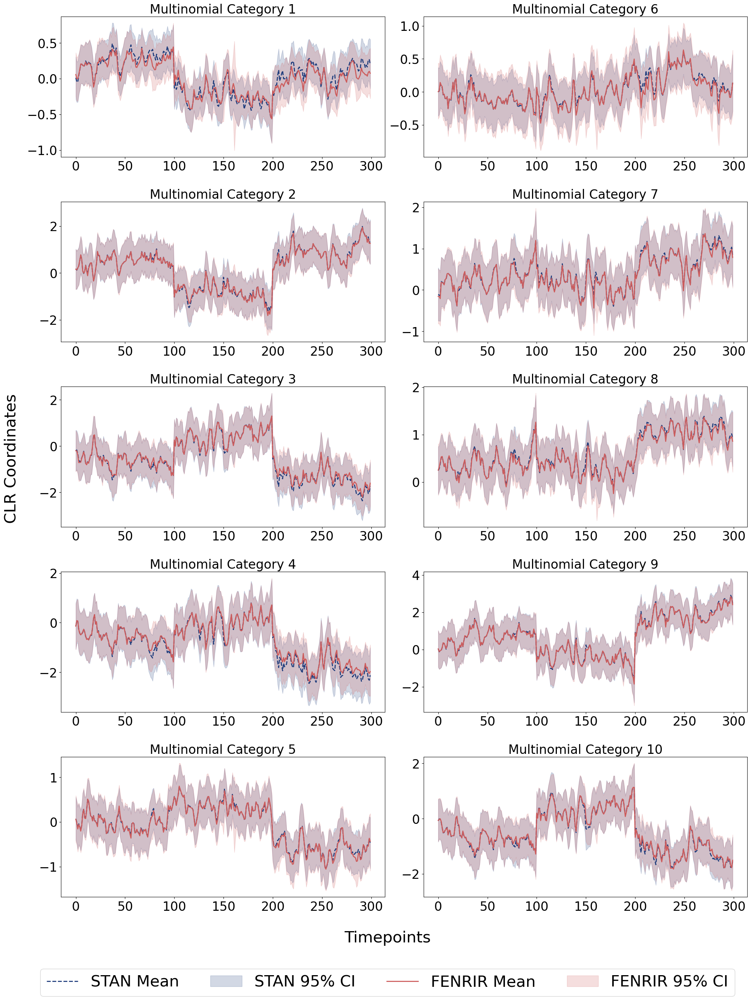

In [93]:
plot_ts_combined(theta_nomcmc_clr, theta_stan_clr, [100,100,100], 3, 123, (0,300))

### Simulated ESS Plots

In [ ]:
fit = None
with open("./N300_D3_Q1_R1_W0.45_pm5_sc_0_1/fit.pkl", 'rb') as file:
    fit = pkl.load(file)

base_nomcmc.load("./N300_D3_Q1_R1_W0.45_pm5_mycpp_0_1/result_optim.RData")
data = r['result_optim']
data_py = list(data)
cpp_optim_time = data_py[2][0]/1000
cpp_dir_time = data_py[4][0]/1000
cpp_total_time = data_py[5][0]

summary = fit.summary()

In [ ]:
summary_theta = summary[summary.index.str.startswith("theta")]
summary_eta = summary[summary.index.str.startswith("eta")]

In [ ]:
summary_theta.iloc[:,7].mean(), summary_eta.iloc[:,7].mean()

In [ ]:
cpp_total_time, 2000/cpp_total_time, 2000/(cpp_optim_time+cpp_dir_time)

In [91]:
def plot_ess_comparison(stan_esspersec, ours_esspersec, title="Effective Sample Size per Second Comparison"):
    fig, ax = plt.subplots(figsize=(4, 4))
    
    width = 0.2
    ind = np.arange(2)
    
    methods = ['STAN', 'FENRIR']
    values = [stan_esspersec, ours_esspersec]
    colors = [blue_color, red_color]
    
    bars = ax.bar(ind, values, width, color=colors)
    
    ax.set_ylabel('NEff/s', fontsize=12)
    ax.set_xticks(ind)
    ax.set_xticklabels(methods, fontsize=12)
    
    def autolabel(rects):
        for rect in rects:
            height = rect.get_height()
            ax.annotate(f'{height:.2f}',
                        xy=(rect.get_x() + rect.get_width() / 2, height),
                        xytext=(0, 3), 
                        textcoords="offset points",
                        ha='center', va='bottom', fontsize=10)
    
    autolabel(bars)
    
    plt.tight_layout(pad=1.5) 
    
    plt.subplots_adjust(top=0.9)
    
    ax.set_ylim(0, max(values) * 1.1)
    plt.savefig(f"{plot_path}/plots/neffs_simulated.pdf", format="pdf", bbox_inches="tight")
    plt.show()

In [ ]:
plot_ess_comparison(15.39,12329)

### Mallard ESS Plots

In [80]:
result_path = "random_path_where_results_on_microbiome_data_are_stored"
os.chdir(result_path)

In [81]:
base_nomcmc_mallard = importr('base')
base_nomcmc_mallard.load('./cpp/result_theta_dir_without_mcmc_clr_gibbs.RData')
data_nomcmc_mallard_clr = r['smoothed_theta_nomcmc_clr']
theta_nomcmc_mallard_clr = np.array(data_nomcmc_mallard_clr).transpose(1,2,0)

In [82]:
fit_mallard = None
with open("./stan/fit.pkl", 'rb') as file:
    fit_mallard = pkl.load(file)

theta_stan_mallard = fit_mallard.stan_variable("theta",inc_warmup=False)[:,:,:,:]
theta_stan_mallard = theta_stan_mallard.squeeze().transpose(2,1,0)
theta_stan_mallard_clr = []

for i in range(theta_stan_mallard.shape[2]):
    proportion = alr_inv(theta_stan_mallard[:,:,i].T)
    theta_stan_mallard_clr.append(clr(proportion).T)

theta_stan_mallard_clr = np.array(theta_stan_mallard_clr).transpose(1,2,0)
print(theta_stan_mallard_clr.shape, theta_nomcmc_mallard_clr.shape)

(10, 2692, 12000) (10, 2692, 4000)


In [85]:
az_stan = az.convert_to_inference_data(theta_stan_mallard_clr.reshape(10, 2692, 4, 3000).transpose(2, 3, 0, 1).reshape(4, 3000, -1))
az_cpp = az.convert_to_inference_data(theta_nomcmc_mallard_clr.transpose(2, 0, 1).reshape(1, 4000, 10, 2692).reshape(1,4000,-1))
ess_value_stan = az.ess(az_stan)
ess_value_cpp = az.ess(az_cpp)

In [86]:
ess_value_stan = ess_value_stan["x"].mean().item()
ess_value_cpp = ess_value_cpp["x"].mean().item()
ess_value_stan, ess_value_cpp

(11797.300777849621, 3901.404733752605)

In [87]:
stan_time = 38170
cpp_time = 1.46 * 3600
cpp_time, stan_time

(5256.0, 38170)

In [88]:
stan_esspersec = ess_value_stan/stan_time
cpp_esspersec = ess_value_cpp/cpp_time

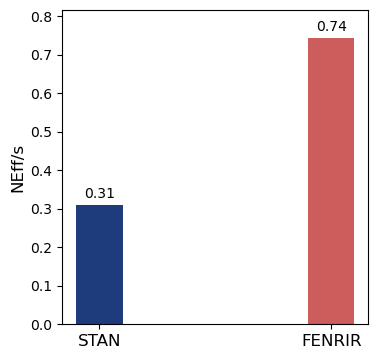

In [92]:
plot_ess_comparison(stan_esspersec,cpp_esspersec)

### Mallard Velocity

In [133]:
result_path = "random_path_where_results_on_microbiome_data_are_stored_for_linear_trend_model"
os.chdir(result_path)

In [134]:
seq_list = ["seq_6","seq_15","seq_5","seq_10","seq_1","seq_2","seq_14","seq_23","seq_9" ,"seq_4"]

family_names = [
    "Synergistaceae", 
    "Fusobacteriaceae", 
    "Acidaminococcaceae", 
    "Ruminococcaceae", 
    "Lachnospiraceae", 
    "Rikenellaceae", 
    "Bacteroidaceae", 
    "Porphyromonadaceae", 
    "Desulfovibrionaceae", 
    "Enterobacteriaceae"
]

In [144]:
def plot_theta_multi_ts(samples, stan_samples, N_total_list, save_path, num_of_timeseries=4, num_of_features=10, seed=123, which_times=(0, 100), label_suffixes = ["ours","stan"]):
    np.random.seed(seed)

    samples_mean = np.mean(samples, axis=2)
    samples_2_5_matrix = np.percentile(samples, 2.5, axis=2)
    samples_97_5_matrix = np.percentile(samples, 97.5, axis=2)

    stan_samples_mean = np.mean(stan_samples, axis=2)
    stan_samples_2_5_matrix = np.percentile(stan_samples, 2.5, axis=2)
    stan_samples_97_5_matrix = np.percentile(stan_samples, 97.5, axis=2)

    # Create 10x4 subplots
    fig, axs = plt.subplots(num_of_features, num_of_timeseries, figsize=(30, 40), squeeze=False, sharex=True)  # Adjust figsize as needed

    handles = []
    
    for feature_index in range(num_of_features):
        cum_index = 0  # Reset for each feature
        for ts_index in range(num_of_timeseries):
            ax = axs[feature_index, ts_index]

            # Extract data for the selected feature across the current time series
            selected_mean = samples_mean[feature_index, cum_index:cum_index + N_total_list[ts_index]]
            selected_percentile_2_5 = samples_2_5_matrix[feature_index, cum_index:cum_index + N_total_list[ts_index]]
            selected_percentile_97_5 = samples_97_5_matrix[feature_index, cum_index:cum_index + N_total_list[ts_index]]
            stan_selected_mean = stan_samples_mean[feature_index, cum_index:cum_index + N_total_list[ts_index]]
            stan_selected_percentile_2_5 = stan_samples_2_5_matrix[feature_index, cum_index:cum_index + N_total_list[ts_index]]
            stan_selected_percentile_97_5 = stan_samples_97_5_matrix[feature_index, cum_index:cum_index + N_total_list[ts_index]]
            time_points = np.arange(N_total_list[ts_index])

            # Plot mean lines and confidence intervals
            l1,f1,l2,f2 = "","","",""
            for color, label_suffix in zip([red_color, blue_color], label_suffixes):
                
                if label_suffix == label_suffixes[1]:
                    l1 = ax.plot(time_points[which_times[0]:which_times[1]], stan_selected_mean[which_times[0]:which_times[1]],'--' ,color=color,linewidth=2)
                    f1 = ax.fill_between(time_points[which_times[0]:which_times[1]], stan_selected_percentile_2_5[which_times[0]:which_times[1]], stan_selected_percentile_97_5[which_times[0]:which_times[1]], color=blue_color, alpha=0.2)
                else:
                    l2 = ax.plot(time_points[which_times[0]:which_times[1]], selected_mean[which_times[0]:which_times[1]], color=color,linewidth=2)
                    f2 = ax.fill_between(time_points[which_times[0]:which_times[1]], selected_percentile_2_5[which_times[0]:which_times[1]], selected_percentile_97_5[which_times[0]:which_times[1]], color=color, alpha=0.2)
            if feature_index == 0:
                handles.extend([l1[0], mpatches.Patch(color=blue_color, alpha=0.2), l2[0], mpatches.Patch(color=red_color, alpha=0.2)])
            ax.set_title(f'{family_names[feature_index]}- Vessel {ts_index + 1}', fontsize=30)
            ax.grid(False)
            ax.margins(0, 0)
            ax.xaxis.set_tick_params(labelsize=28)
            ax.yaxis.set_tick_params(labelsize=28)
            cum_index += N_total_list[ts_index]
 
    fig.legend(handles, ['STAN Mean', 'STAN 95% CI', 'FENRIR Mean', 'FENRIR 95% CI'], loc='lower center', bbox_to_anchor=(0.5, -0.06), ncol=4, fontsize=42)
    fig.text(0.5, -0.01, 'Time (Hours)', ha='center', va='center', fontsize=48)
    fig.text(0.0, 0.5, 'CLR Coordinates', ha='center', va='center', rotation='vertical', fontsize=48)
    plt.tight_layout()
    plt.savefig(save_path, format="pdf", bbox_inches="tight")
    plt.show()

#### No prior

In [11]:
base_nomcmc_mallard = importr('base')
base_nomcmc_mallard.load('./cpp/result_theta_dir_without_mcmc_clr.RData')
data_nomcmc_mallard_clr = r['smoothed_theta_nomcmc_clr']
theta_nomcmc_mallard_clr = np.array(data_nomcmc_mallard_clr).transpose(1,2,3,0)

In [6]:
fit_mallard = None
with open("./stan/fit.pkl", 'rb') as file:
    fit_mallard = pkl.load(file)

theta_stan_mallard = fit_mallard.stan_variable("theta",inc_warmup=False)[:,:,:,:]
theta_stan_mallard = theta_stan_mallard.transpose(2,3,1,0)

theta_stan_mallard_clr = []
alpha_stan_mallard_clr = []
for i in range(theta_stan_mallard.shape[3]):
    proportion = alr_inv(theta_stan_mallard[0,:,:,i].T)
    theta_stan_mallard_clr.append(clr(proportion).T)
    proportion = alr_inv(theta_stan_mallard[1,:,:,i].T)
    alpha_stan_mallard_clr.append(clr(proportion).T)

theta_stan_mallard_clr = np.array(theta_stan_mallard_clr).transpose(1,2,0)
alpha_stan_mallard_clr = np.array(alpha_stan_mallard_clr).transpose(1,2,0)
print(theta_stan_mallard_clr.shape, theta_nomcmc_mallard_clr.shape, alpha_stan_mallard_clr.shape)

(10, 2692, 4000) (2, 10, 2692, 2000) (10, 2692, 4000)


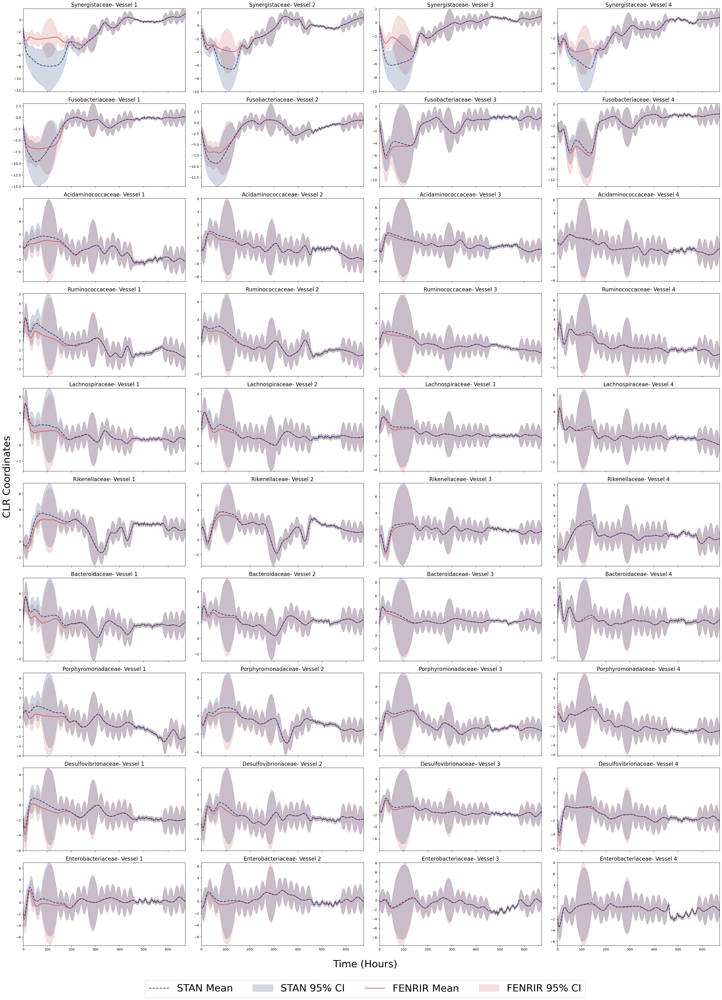

In [12]:
plot_theta_multi_ts(theta_nomcmc_mallard_clr[0,:,:,:],theta_stan_mallard_clr[:,:,:], [673,673,673,673], num_of_timeseries=4, num_of_features=10, seed=123, which_times=(0, 673), label_suffixes = ["ours","stan"])

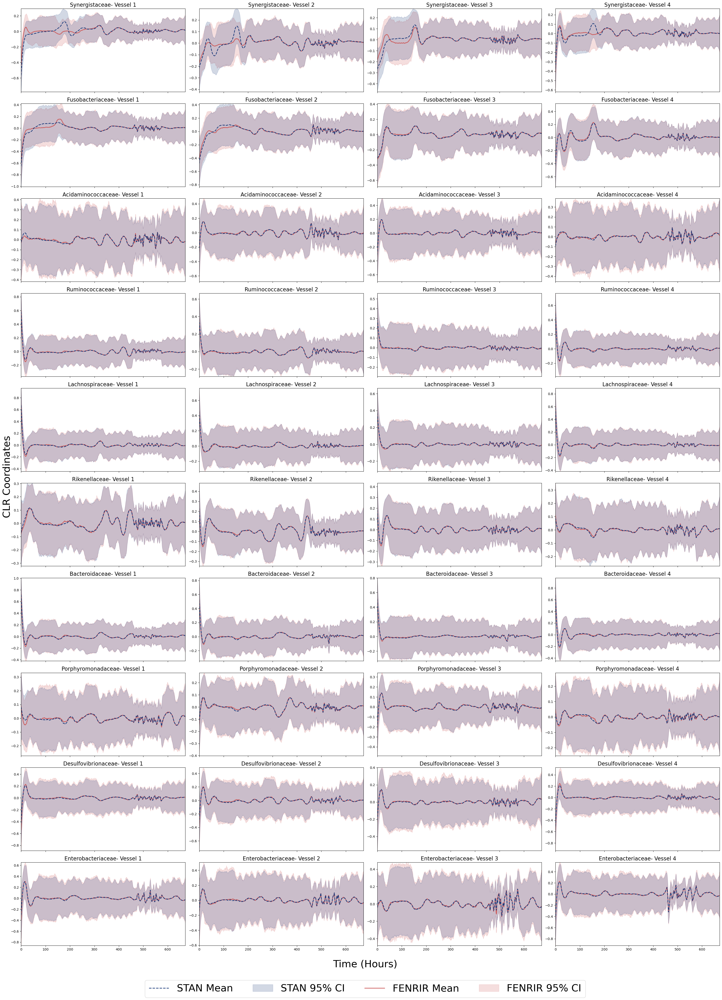

In [13]:
plot_theta_multi_ts(theta_nomcmc_mallard_clr[1,:,:,:],alpha_stan_mallard_clr[:,:,:], [673,673,673,673], num_of_timeseries=4, num_of_features=10, seed=123, which_times=(0, 673), label_suffixes = ["ours","stan"])

#### Inverse Gamma Prior

In [136]:
base_nomcmc_mallard = importr('base')
base_nomcmc_mallard.load('./cpp/result_theta_dir_without_mcmc_clr_gibbs.RData')
data_nomcmc_mallard_clr = r['smoothed_theta_nomcmc_clr']
theta_nomcmc_mallard_clr = np.array(data_nomcmc_mallard_clr).transpose(1,2,0)

In [137]:
fit_mallard = None
with open("./stan/fit.pkl", 'rb') as file:
    fit_mallard = pkl.load(file)

theta_stan_mallard = fit_mallard.stan_variable("theta",inc_warmup=False)[:,:,:,:]
theta_stan_mallard = theta_stan_mallard.transpose(2,3,1,0)

theta_stan_mallard_clr = []
alpha_stan_mallard_clr = []
for i in range(theta_stan_mallard.shape[3]):
    proportion = alr_inv(theta_stan_mallard[0,:,:,i].T)
    theta_stan_mallard_clr.append(clr(proportion).T)
    proportion = alr_inv(theta_stan_mallard[1,:,:,i].T)
    alpha_stan_mallard_clr.append(clr(proportion).T)

theta_stan_mallard_clr = np.array(theta_stan_mallard_clr).transpose(1,2,0)
alpha_stan_mallard_clr = np.array(alpha_stan_mallard_clr).transpose(1,2,0)
print(theta_stan_mallard_clr.shape, alpha_stan_mallard_clr.shape, theta_nomcmc_mallard_clr.shape)

(10, 2692, 12000) (10, 2692, 12000) (10, 5384, 4000)


In [138]:
W_theta_stan = fit_mallard.stan_variable("W_theta",inc_warmup=False)
W_alpha_stan = fit_mallard.stan_variable("W_alpha",inc_warmup=False)

In [139]:
W_base = importr('base')
W_base.load('./cpp/W_gibbs.RData')
W_data = r['W_z']
W_data = np.array(W_data)[1000:,:]

In [140]:
W_theta_stan.shape, W_alpha_stan.shape, W_data.shape

((12000,), (12000,), (3000, 2))

In [141]:
W_theta_stan.mean(), np.percentile(W_theta_stan, 2.5), np.percentile(W_theta_stan, 97.5), W_alpha_stan.mean(), np.percentile(W_alpha_stan, 2.5), np.percentile(W_alpha_stan, 97.5)

(0.1185366632,
 0.10373755,
 0.13536602499999997,
 0.02074585790833333,
 0.019063189999999997,
 0.02258085)

In [142]:
W_data[:,0].mean(), np.percentile(W_data[:,0], 2.5), np.percentile(W_data[:,0], 97.5), W_data[:,1].mean(), np.percentile(W_data[:,1], 2.5), np.percentile(W_data[:,1], 97.5)

(0.1204502731426838,
 0.10447526027810153,
 0.13509119702625386,
 0.020397735150342912,
 0.018760443326372556,
 0.022153162168137848)

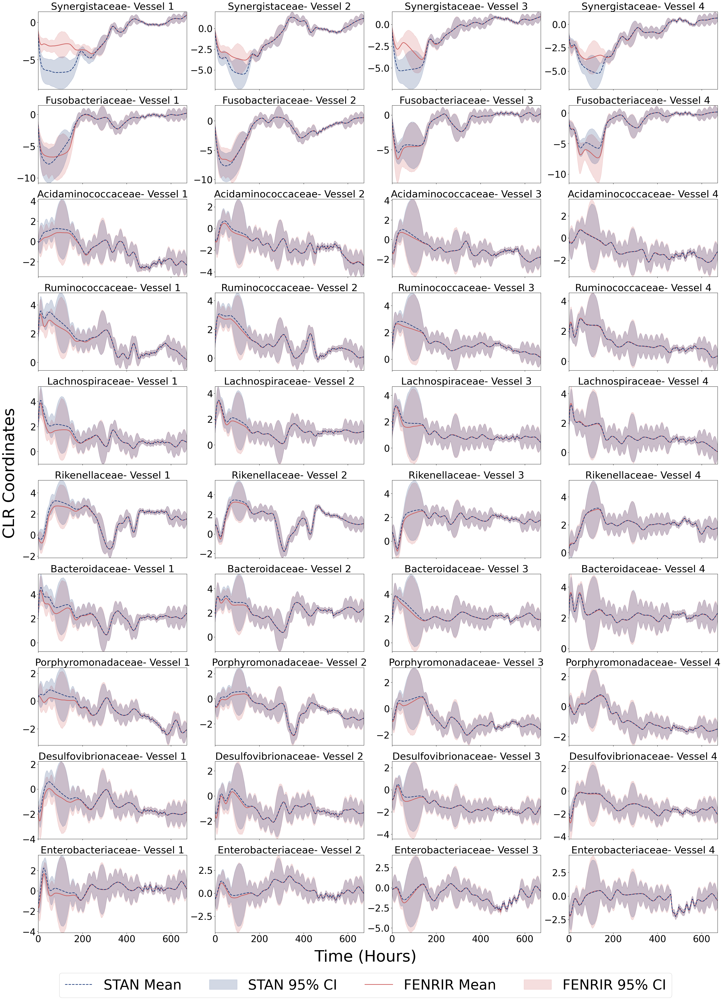

In [145]:
plot_theta_multi_ts(theta_nomcmc_mallard_clr[:,:2692,:],theta_stan_mallard_clr, [673,673,673,673], num_of_timeseries=4, num_of_features=10, seed=123, which_times=(0, 673), save_path=f"{plot_path}/plots/all_mallard_nomcmc_velocity_theta.pdf")

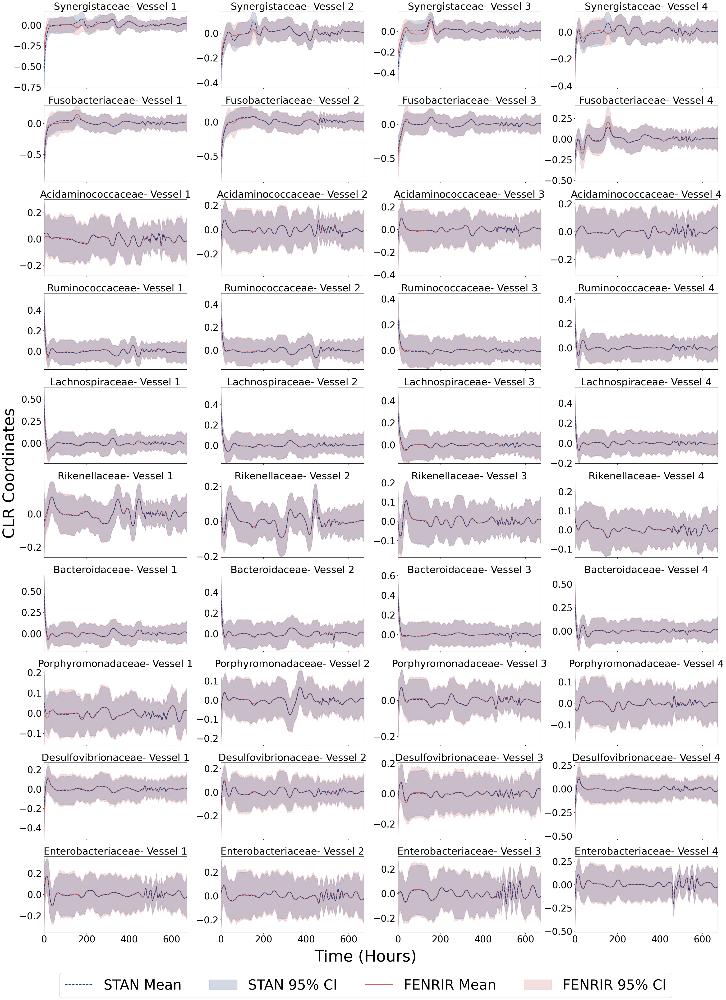

In [146]:
plot_theta_multi_ts(theta_nomcmc_mallard_clr[:,2692:,:],alpha_stan_mallard_clr, [673,673,673,673], num_of_timeseries=4, num_of_features=10, seed=123, which_times=(0, 673), save_path = f"{plot_path}/plots/all_mallard_nomcmc_velocity_alpha.pdf")

In [195]:
theta_stan_mallard_clr.shape, alpha_stan_mallard_clr.shape, theta_nomcmc_mallard_clr.shape

((10, 2692, 12000), (10, 2692, 12000), (10, 5384, 4000))

In [196]:
import arviz as az
az_stan = az.convert_to_inference_data(theta_stan_mallard_clr.reshape(10, 2692, 4, 3000).transpose(2, 3, 0, 1).reshape(4, 3000, -1))
az_cpp = az.convert_to_inference_data(theta_nomcmc_mallard_clr[:,:2692,:].transpose(2, 0, 1).reshape(1, 4000, 10, 2692).reshape(1,4000,-1))
ess_value_stan = az.ess(az_stan)
ess_value_cpp = az.ess(az_cpp)

In [197]:
ess_value_stan = ess_value_stan["x"].mean().item()
ess_value_cpp = ess_value_cpp["x"].mean().item()
ess_value_stan, ess_value_cpp

(11416.992669696107, 3889.2289967279917)

In [198]:
alpha_az_stan = az.convert_to_inference_data(alpha_stan_mallard_clr.reshape(10, 2692, 4, 3000).transpose(2, 3, 0, 1).reshape(4, 3000, -1))
alpha_az_cpp = az.convert_to_inference_data(theta_nomcmc_mallard_clr[:,2692:,:].transpose(2, 0, 1).reshape(1, 4000, 10, 2692).reshape(1,4000,-1))
alpha_ess_value_stan = az.ess(alpha_az_stan)
alpha_ess_value_cpp = az.ess(alpha_az_cpp)

In [199]:
alpha_ess_value_stan = alpha_ess_value_stan["x"].mean().item()
alpha_ess_value_cpp = alpha_ess_value_cpp["x"].mean().item()
alpha_ess_value_stan, alpha_ess_value_cpp

(11777.737151867112, 3897.2054813887685)

In [200]:
stan_time = 12*60*60
base_nomcmc_mallard.load('./cpp/time_list.RData')
cpp_time = r['time_list']
cpp_time = cpp_time[0][0] * 3600
cpp_time, stan_time

(6709.411247968674, 43200)

In [201]:
stan_esspersec = ess_value_stan/stan_time
cpp_esspersec = ess_value_cpp/cpp_time

alpha_stan_esspersec = alpha_ess_value_stan/stan_time
alpha_cpp_esspersec = alpha_ess_value_cpp/cpp_time

stan_esspersec, cpp_esspersec, alpha_stan_esspersec, alpha_cpp_esspersec

(0.2642822377244469,
 0.5796677015297708,
 0.27263280444136834,
 0.5808565516935152)

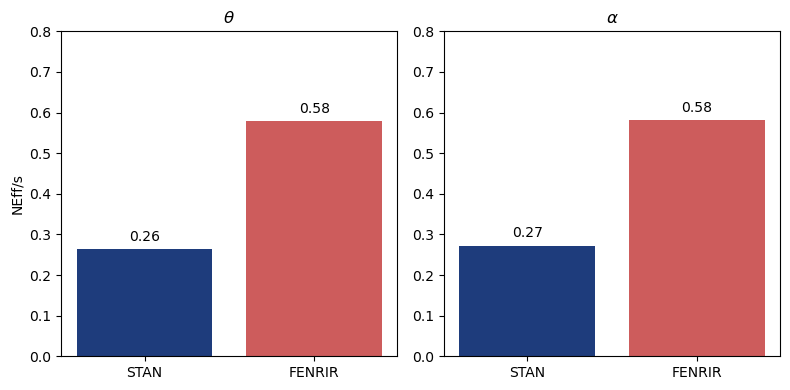

In [202]:
neff_theta = [stan_esspersec, cpp_esspersec]  
neff_alpha = [alpha_stan_esspersec, alpha_cpp_esspersec]

labels = ['STAN', 'FENRIR']

fig, axes = plt.subplots(1, 2, figsize=(8, 4))  
axes[0].bar(labels, neff_theta, color=[blue_color, red_color])

for i, v in enumerate(neff_theta):
    axes[0].text(i, v + 0.02, f'{v:.2f}', ha='center', fontsize=10)

axes[0].set_ylabel('NEff/s')
axes[0].set_ylim(0, 0.8)
axes[0].set_title(r'$\theta$')

axes[1].bar(labels, neff_alpha, color=[blue_color, red_color])

for i, v in enumerate(neff_alpha):
    axes[1].text(i, v + 0.02, f'{v:.2f}', ha='center', fontsize=10)

axes[1].set_ylim(0, 0.8)
axes[1].set_title(r'$\alpha$')

plt.tight_layout()

plt.savefig(f"{plot_path}/plots/neffs_mallard_velocity.pdf", format="pdf", bbox_inches="tight")
plt.show()
